### Metrics calculation

This notebook loads Nominatim-geocoded, BERT-recognized location entities and calculate dataset metrics 

>**__Note:__** KEEP FULL DATASET FROM THE BEGINING

In [13]:
import geopandas as gpd
import seaborn as sns

from shapely.geometry import Point, Polygon

# Use a sans-serif font
import matplotlib.pyplot as plt
from matplotlib import font_manager as fm
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['DeJavu Serif']


findfont: Font family ['CMU Sans Serif'] not found. Falling back to DejaVu Sans.


1. Preprocess data, get basic geoparsing metrics and descriptive statistics metrics
	- save final gdf
	- maybe include tiktok here? and plot posts over time

# Geo-parsing metrics

- *percentage of posts with recognized location entities*: the proportion of posts that contain identifiable location entities (e.g., place names, addresses); 

- *percentage of geocoded posts*: the percentage of posts for which location entities are successfully converted into geographic coordinates;

- *percentage of locations in study area*: the portion of extracted locations that fall within the defined study area;

- *percentage of unique locations*: the proportion of distinct or unique locations identified in the dataset.

## VISUALIZATION

Grouped bar chart in text, table with counts in appendix

In [2]:
import pandas as pd
import folium
import numpy as np
from folium.plugins import FastMarkerCluster
import pprint

from matplotlib import pyplot as plt
import datetime
from matplotlib.cm import get_cmap

import geopandas as gpd
import seaborn as sns

from shapely.geometry import Point, Polygon

from matplotlib import font_manager as fm
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['DeJavu Serif']


In [3]:
df = pd.read_csv("final_datasets/final_geoparsed.csv", index_col=False)
df.drop(['Unnamed: 0'], axis=1, inplace=True)
# We have issue with geoparsing - empty locations were geocoded as well cause you stupid
most_used_latitude = df['latitude'].value_counts().idxmax()
most_used_longitude = df['longitude'].value_counts().idxmax()
print(most_used_latitude)
print(most_used_longitude)
df.loc[df['latitude'] == most_used_latitude, 'latitude'] = np.nan
df.loc[df['longitude'] == most_used_longitude, 'longitude'] = np.nan

C:\Users\vrace\AppData\Local\Temp\ipykernel_14060\588950840.py:1: DtypeWarning: Columns (1,2,13) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("final_datasets/final_geoparsed.csv", index_col=False)


46.3144754
11.0480288


In [55]:
df.sample(10)

,id,date,text,edited_text,source,GPE,FAC,LOC,ORG,locations,latitude,longitude,datetime
325615,7148470324454083882,1664382969,"it’s Ian, thanks #hurricane #hurricaineian #ia...",it s ian thanks hurricane hurricaineian ian av...,Tiktok,'florida',NaN,NaN,NaN,florida,27.7567667,-81.4639835,2022-09-28 16:36:09
215480,1575918903691071488,2022-09-30 18:42:00.000000000,"Another iconic Collier County staple, destroye...",another iconic collier county staple destroyed...,Twitter,'marco island',NaN,NaN,NaN,marco island,25.9363356,-81.7156832,NaN
51143,iq9ppwl,2022-09-28 18:44:26,"Weather is essentially driven by energy, which...",weather is essentially driven by energy which ...,Reddit Comments,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
87376,iqedsve,2022-09-29 18:32:44,Sopaprizzle Sprizzle,sopaprizzle sprizzle,Reddit Comments,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
241228,7149396497593830699,1664598603,#fyp #foryoupage #hurricaneian,foryoupage hurricaneian,Tiktok,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022-10-01 04:30:03
124033,iqlvodm,2022-10-01 09:55:41,"Darwin's law still works, the weak, in this ca...",darwin s law still works the weak in this case...,Reddit Comments,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
246716,7149303605252705582,1664576967,Myrtle beach SC on coast after the hurricane ...,myrtle beach sc on coast after the hurricane,Tiktok,'myrtle beach',NaN,NaN,NaN,myrtle beach,33.6956461,-78.8900409,2022-09-30 22:29:27
373253,7145836049502342446,1663769650,#hurricanefiona #puertorico #paramedic #emt #e...,hurricanefiona puertorico paramedic emt emergency,Tiktok,NaN,NaN,NaN,'hurricanefiona puertorico paramedic emt',hurricanefiona puertorico paramedic emt,NaN,NaN,2022-09-21 14:14:10
73821,iqc505r,2022-09-29 06:21:47,I hope you came out safe,i hope you came out safe,Reddit Comments,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
238545,7149559481452547371,1664636550,thank god this is all that happened to us. #BR...,thank god this is all that happened to us brad...,Tiktok,NaN,NaN,NaN,"'bradenton palmasolabay', 'tampabay riverview ...","bradenton palmasolabay, tampabay riverview cor...",NaN,NaN,2022-10-01 15:02:30


## Visualize posts with hurricane over the time

C:\Users\vrace\AppData\Local\Temp\ipykernel_9344\1671596540.py:18: FutureWarning: The behavior of 'to_datetime' with 'unit' when parsing strings is deprecated. In a future version, strings will be parsed as datetime strings, matching the behavior without a 'unit'. To retain the old behavior, explicitly cast ints or floats to numeric type before calling to_datetime.
  group_df['datetime'] = pd.to_datetime(group_df['date'], unit='s')


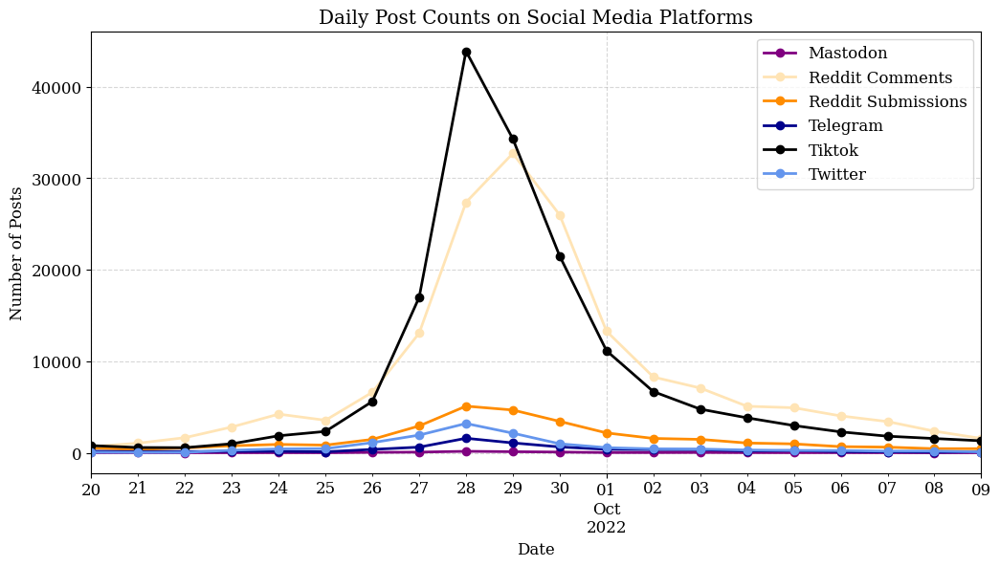

In [42]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

date_df = df.copy()
grouped = date_df.groupby("source")

plt.figure(figsize=(12, 6))

# Separate df for TikTok updates
updated_tiktok_df = pd.DataFrame()

# Df to keep all other sources
other_sources_df = pd.DataFrame()

for source, group_df in grouped:
    if source == "Tiktok":
        group_df['datetime'] = pd.to_datetime(group_df['date'], unit='s')
        updated_tiktok_df = group_df
    else:
        group_df['datetime'] = pd.to_datetime(group_df['date'], format='mixed')
        other_sources_df = pd.concat([other_sources_df, group_df])

updated_tiktok_df.drop_duplicates(subset=['id'], inplace=True)
# Combine updated TikTok data with other sources
other_sources_df = other_sources_df[other_sources_df['datetime'] >= '2022-09-20']
combined_df = pd.concat([other_sources_df, updated_tiktok_df])


# Set datetime as index for plotting
combined_df.set_index('datetime', inplace=True)

color_map = {
    'Twitter': 'cornflowerblue',
    'Tiktok': 'black',
    'Reddit Submissions': 'darkorange',
    'Reddit Comments': 'moccasin',
    'Telegram': 'darkblue',
    'Mastodon': 'purple'
}
# Plotting
grouped_combined = combined_df.groupby('source')
for source, group_df in grouped_combined:
    posts_count = group_df.resample('D').size()
    posts_count.plot(kind='line', marker='o', linestyle='-', linewidth=2, label=f'{source}', color=color_map.get(source, 'black'))



# Set plot labels and title
plt.xlabel('Date')
plt.ylabel('Number of Posts')
plt.title('Daily Post Counts on Social Media Platforms')
plt.legend()
plt.grid(True)
plt.grid(True, linestyle='--', alpha=0.5) 
plt.show()

# Return the updated date_df
date_df = combined_df.reset_index(drop=False)
date_df.drop(columns=['date'], inplace=True)
date_df.rename(columns={'datetime': 'date'}, inplace=True)
date_df = date_df[["id",'date', 'text', 'edited_text', 'source', 'latitude', 'longitude']]
# date_df.to_csv("datasets/florida_df_good_date.csv")


## Calcualte geoparsing metrics

In [4]:

# Group by 'source' and calculate the required metrics
grouped = df.groupby('source')

# To clip geocoded dataset to include only florida
df['longitude'] = pd.to_numeric(df['longitude'], errors='coerce')
df['latitude'] = pd.to_numeric(df['latitude'], errors='coerce')
florida_bbox = {
    'min_lon': -87.634643,
    'max_lon': -79.974306,
    'min_lat': 24.396308,
    'max_lat': 31.000888
}

# For results
results_list = []

for name, group in grouped:
    ler_count = group['locations'].notna().sum()
    geocode_count = group['latitude'].notna().sum()
    total_count = len(group)

    ler_percentage = (ler_count / total_count) * 100
    geocode_percentage = (geocode_count / total_count) * 100
    
    florida_posts = group[
        (group['longitude'].notna()) &
        (group['latitude'].notna()) &
        (group['longitude'] >= florida_bbox['min_lon']) &
        (group['longitude'] <= florida_bbox['max_lon']) &
        (group['latitude'] >= florida_bbox['min_lat']) &
        (group['latitude'] <= florida_bbox['max_lat'])
    ]
    florida_count = len(florida_posts)
    florida_percentage = (florida_count/total_count) * 100

    # Exclude "Florida" from our dataset, as it refers to the whole state
    value_counts = florida_posts['latitude'].value_counts()
    print(value_counts.iloc[0])
    most_used_value = value_counts.idxmax()
    print(most_used_value)
    florida_wihtout_florida = florida_posts[florida_posts['latitude'] != most_used_value]
    florida_without_florida_count = len(florida_wihtout_florida)
    florida_without_florida_percentage = (florida_without_florida_count/total_count) * 100
    
    # Unique locations
    unique_locations = florida_wihtout_florida[['latitude', 'longitude']].drop_duplicates()
    unique_locations_count = len(unique_locations)
    unique_locations_percentage = (unique_locations_count/total_count) * 100
    
    results_list.append({
        'total': total_count,
        'source': name,
        'ler_count': ler_count,
        'Identified locations': ler_percentage,
        'geocode_count': geocode_count,
        'Geocoded locations': geocode_percentage,
        'florida_count': florida_count,
        'Geocoded in Florida': florida_percentage,
        'florida_without_florida_count': florida_without_florida_count,
        "Excluding 'Florida'": florida_without_florida_percentage,
        'unique_locations_count': unique_locations_count, 
        'Distinct locations': unique_locations_percentage,
    })

pprint.pprint(results_list)

37
27.7567667
5126
27.7567667
3910
27.7567667
691
27.7567667
20501
27.7567667
1205
27.7567667
[{'Distinct locations': 2.882483370288248,
  "Excluding 'Florida'": 7.427937915742794,
  'Geocoded in Florida': 11.529933481152993,
  'Geocoded locations': 22.61640798226164,
  'Identified locations': 70.06651884700665,
  'florida_count': 104,
  'florida_without_florida_count': 67,
  'geocode_count': 204,
  'ler_count': 632,
  'source': 'Mastodon',
  'total': 902,
  'unique_locations_count': 26},
 {'Distinct locations': 0.4933445581975851,
  "Excluding 'Florida'": 3.197320161779337,
  'Geocoded in Florida': 6.215081743307763,
  'Geocoded locations': 15.254237288135593,
  'Identified locations': 20.87883622491331,
  'florida_count': 10557,
  'florida_without_florida_count': 5431,
  'geocode_count': 25911,
  'ler_count': 35465,
  'source': 'Reddit Comments',
  'total': 169861,
  'unique_locations_count': 838},
 {'Distinct locations': 1.3755731554814505,
  "Excluding 'Florida'": 8.962067528136723

C:\Users\vrace\AppData\Local\Temp\ipykernel_14060\3760575225.py:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = get_cmap('coolwarm')


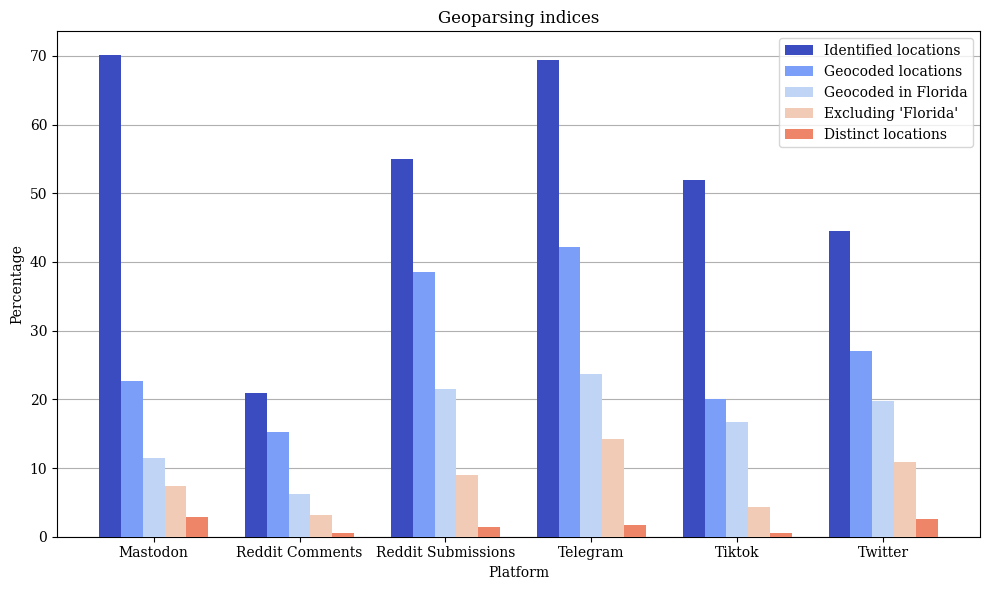

In [6]:
# Extract sources and percentage values
sources = [result['source'] for result in results_list]
percentages = ['Identified locations', 'Geocoded locations', 'Geocoded in Florida', "Excluding 'Florida'", 'Distinct locations']
percentage_values = np.array([[result[percentage] for percentage in percentages] for result in results_list])

# Set up the figure and axes
fig, ax = plt.subplots(figsize=(10, 6))

cmap = get_cmap('coolwarm')  

# Plotting grouped bar chart for each percentage with the same colors
for i, percentage in enumerate(percentages):
    x = np.arange(len(sources))
    ax.bar(x + i * 0.15, [result[i] for result in percentage_values], color=cmap(i / len(percentages)), width=0.15, label=percentage, zorder = 3)

# Set x-axis ticks and labels
ax.set_xticks(np.arange(len(sources)) + 0.3)
ax.set_xticklabels(sources, rotation=0, ha='center', fontsize=10)

# Set labels title
ax.set_xlabel('Platform')
ax.set_ylabel('Percentage')
ax.set_title('Geoparsing indices')
ax.legend()
ax.grid(axis='y', zorder=0)
plt.tight_layout()
plt.show()

In [93]:
# Latex
df_results = pd.DataFrame(results_list)

count_columns = [col for col in df_results.columns if col.endswith('_count')]
df_count = df_results[['source'] + count_columns]

df_transposed = df_count.set_index('source').T

latex_table_transposed = df_transposed.to_latex()
print(latex_table_transposed)

\begin{tabular}{lrrrrrr}
\toprule
source & Mastodon & Reddit Comments & Reddit Submissions & Telegram & Tiktok & Twitter \\
\midrule
ler_count & 632 & 35465 & 17155 & 5042 & 86062 & 6017 \\
geocode_count & 204 & 25911 & 12025 & 3062 & 33249 & 3659 \\
florida_count & 104 & 10557 & 6705 & 1723 & 27620 & 2670 \\
florida_without_florida_count & 67 & 5431 & 2795 & 1032 & 7119 & 1465 \\
unique_locations_count & 26 & 838 & 429 & 126 & 929 & 358 \\
\bottomrule
\end{tabular}



### Finalize df to keep only posts in Florida and without "Florida"

In [3]:
df['longitude'] = pd.to_numeric(df['longitude'], errors='coerce')
df['latitude'] = pd.to_numeric(df['latitude'], errors='coerce')
florida_bbox = {
    'min_lon': -87.634643,
    'max_lon': -79.974306,
    'min_lat': 24.396308,
    'max_lat': 31.000888
}

florida_posts = df[
    (df['longitude'].notna()) &
    (df['latitude'].notna()) &
    (df['longitude'] >= florida_bbox['min_lon']) &
    (df['longitude'] <= florida_bbox['max_lon']) &
    (df['latitude'] >= florida_bbox['min_lat']) &
    (df['latitude'] <= florida_bbox['max_lat'])
]

value_counts = florida_posts['latitude'].value_counts()
most_used_value = value_counts.idxmax()
florida_df = florida_posts[florida_posts['latitude'] != most_used_value]
florida_df.drop(['GPE',	'FAC',	'LOC',	'ORG',	'locations'], axis=1, inplace=True)

C:\Users\vrace\AppData\Local\Temp\ipykernel_26840\4206874209.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  florida_df.drop(['GPE',	'FAC',	'LOC',	'ORG',	'locations'], axis=1, inplace=True)


In [4]:
# Merge with twitter georefrenced dataset
tweet_df = pd.read_csv('datasets/original_georeferenced_points_twitter.csv')
tweet_df.drop('Unnamed: 0', axis=1, inplace=True)
tweet_df["source"] = 'Twitter Geotagged' 
tweet_df = tweet_df[["id",'date', 'text', 'edited_text', 'source', 'latitude', 'longitude']]
florida_df = pd.concat([florida_df, tweet_df], ignore_index=True)
florida_df.to_csv("datasets/florida_df.csv")

In [10]:
florida_df.to_csv("final_datasets/final_geocoded.csv")

In [92]:
location_counts = tweet_df.groupby(['latitude', 'longitude']).size().reset_index(name='count')
top_10_locations = location_counts.sort_values(by='count', ascending=False).head(20)
print(top_10_locations)

       latitude  longitude  count
1288  28.501679 -81.367773    946
937   27.996595 -82.442694    750
108   25.782354 -80.233329    469
792   27.795720 -82.672903    337
456   26.622149 -81.823177    318
930   27.992711 -82.755341    312
1685  30.476215 -84.266174    245
270   26.150368 -80.149173    186
1543  29.673172 -82.330269    163
470   26.636480 -81.986834    163
638   27.341121 -82.533074    163
123   25.816965 -80.132963    136
344   26.373976 -80.134986    117
272   26.152407 -81.791977    107
691   27.473975 -82.573675     96
981   28.049601 -81.972705     93
1042  28.140217 -81.476677     92
1300  28.529141 -81.185067     88
414   26.533486 -80.112904     86
806   27.827367 -82.306723     85


In [40]:
# Create a folium map
folium_map = folium.Map(location=[28.798259, -81.327062], zoom_start=5, tiles='CartoDB dark_matter')

# Add fast marker cluster
FastMarkerCluster(florida_df[['latitude', 'longitude']].values.tolist()).add_to(folium_map)
# Add layer control to the map
folium.LayerControl().add_to(folium_map)

# Iterate over rows of final DataFrame and add CircleMarkers
for _, row in florida_df.iterrows():
    folium.CircleMarker(location=(row["latitude"], row["longitude"]),
                        radius=10,
                        color="#007849",
                        #popup=row['locations'],
                        fill=False).add_to(folium_map)

# Display the map
folium_map


In [97]:

# Define the center of the map based on the bounding box coordinates
center_lat = (florida_bbox['min_lat'] + florida_bbox['max_lat']) / 2
center_lon = (florida_bbox['min_lon'] + florida_bbox['max_lon']) / 2

# Create a Folium map centered on the calculated center coordinates
m = folium.Map(location=[center_lat, center_lon], zoom_start=7)

# Define the bounding box corners
sw = [florida_bbox['min_lat'], florida_bbox['min_lon']]  # Southwest corner (min_lat, min_lon)
ne = [florida_bbox['max_lat'], florida_bbox['max_lon']]  # Northeast corner (max_lat, max_lon)

# Add a rectangle overlay to the map representing the bounding box
folium.Rectangle(bounds=[sw, ne], color='red', fill=False).add_to(m)

# Display the map



# Timeseries 
Important: show how much does this differ from a total number of posts 
    - because then some days have higher accuracy for ler and geocoding

C:\Users\vrace\AppData\Local\Temp\ipykernel_9344\1940340329.py:18: FutureWarning: The behavior of 'to_datetime' with 'unit' when parsing strings is deprecated. In a future version, strings will be parsed as datetime strings, matching the behavior without a 'unit'. To retain the old behavior, explicitly cast ints or floats to numeric type before calling to_datetime.
  group_df['datetime'] = pd.to_datetime(group_df['date'], unit='s')


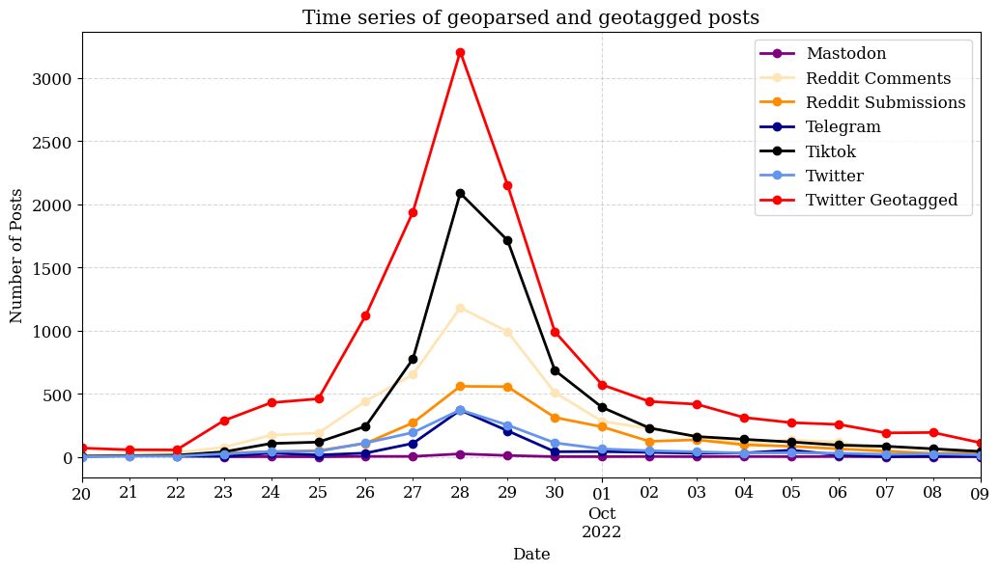

In [99]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

date_df = df.copy()
grouped = florida_df.groupby("source")

plt.figure(figsize=(12, 6))

updated_tiktok_df = pd.DataFrame()

other_sources_df = pd.DataFrame()

for source, group_df in grouped:
    if source == "Tiktok":
        group_df['datetime'] = pd.to_datetime(group_df['date'], unit='s')
        updated_tiktok_df = group_df
    else:
        group_df['datetime'] = pd.to_datetime(group_df['date'], format='mixed')
        other_sources_df = pd.concat([other_sources_df, group_df])

updated_tiktok_df.drop_duplicates(subset=['id'], inplace=True)
other_sources_df = other_sources_df[other_sources_df['datetime'] >= '2022-09-20']
combined_df = pd.concat([other_sources_df, updated_tiktok_df])


# Set datetime as index for plotting
combined_df.set_index('datetime', inplace=True)

color_map = {
    'Twitter': 'cornflowerblue',
    'Tiktok': 'black',
    'Reddit Submissions': 'darkorange',
    'Reddit Comments': 'moccasin',
    'Telegram': 'darkblue',
    'Mastodon': 'purple',
    'Twitter Geotagged': 'red',

}
# Plotting
grouped_combined = combined_df.groupby('source')
for source, group_df in grouped_combined:
    posts_count = group_df.resample('D').size()
    posts_count.plot(kind='line', marker='o', linestyle='-', linewidth=2, label=f'{source}', color=color_map.get(source, 'black'))



# Set plot labels and title
plt.xlabel('Date')
plt.ylabel('Number of Posts')
plt.title('Time series of geoparsed and geotagged posts')
plt.legend()
plt.grid(True)

plt.grid(True, linestyle='--', alpha=0.5) 
plt.show()

# Return the updated date_df
date_df = combined_df.reset_index(drop=False)
date_df.drop(columns=['date'], inplace=True)
date_df.rename(columns={'datetime': 'date'}, inplace=True)
date_df = date_df[["id",'date', 'text', 'edited_text', 'source', 'latitude', 'longitude']]


## Methodology

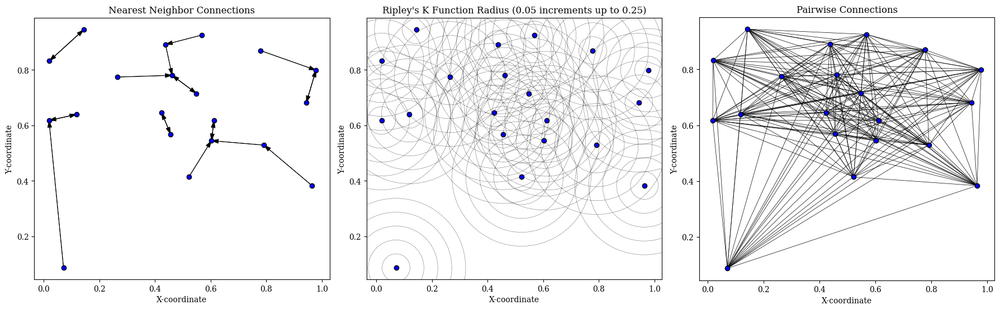

In [40]:
from scipy.spatial import cKDTree

# Generate 20 random points in 2D space
np.random.seed(0)
points = np.random.rand(20, 2)

# Calculate nearest neighbors
tree = cKDTree(points)
distances, indices = tree.query(points, k=2)  # Query nearest neighbor distances and indices

# Create a figure with three subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# Plotting the points and connecting nearest neighbors with arrows in the first subplot
axs[0].scatter(points[:, 0], points[:, 1], c='blue', edgecolor='black', zorder=2)
for i in range(len(points)):
    x1, y1 = points[i]
    x2, y2 = points[indices[i, 1]]  # Nearest neighbor
    
    # Calculate direction and distance
    dx = x2 - x1
    dy = y2 - y1
    length = np.sqrt(dx**2 + dy**2)
    
    # Shorten the arrow length relative to the distance between points
    arrow_length = 0.2 * length  # Adjust factor as needed
    
    # Plot arrow with adjusted length
    axs[0].arrow(x1, y1, dx, dy, color='black', head_width=0.015, head_length=0.025, linewidth=0.5, length_includes_head=True)

axs[0].set_title('Nearest Neighbor Connections')
axs[0].set_xlabel('X-coordinate')
axs[0].set_ylabel('Y-coordinate')
axs[0].set_aspect('equal', adjustable='box')

# Calculate the extent of the points in the first subplot
x_min, x_max = axs[0].get_xlim()
y_min, y_max = axs[0].get_ylim()



# Plotting circles around each point at regular intervals in the second subplot
axs[1].scatter(points[:, 0], points[:, 1], c='blue', edgecolor='black', zorder=2)
for i in range(len(points)):
    x1, y1 = points[i]
    
    # Plot circles around each point at 0.1 distance intervals
    circle_radius = 0.05
    for j in range(1, 6):  # 5 circles
        circle = plt.Circle((x1, y1), j * circle_radius, color='black', linestyle='--', fill=False, linewidth=0.3)
        axs[1].add_patch(circle)

# Set the extent of the second subplot to match the first subplot
axs[1].set_xlim(x_min, x_max)
axs[1].set_ylim(y_min, y_max)

axs[1].set_title("Ripley's K Function Radius (0.05 increments up to 0.25)")
axs[1].set_xlabel('X-coordinate')
axs[1].set_ylabel('Y-coordinate')
axs[1].set_aspect('equal', adjustable='box')


# Plotting pairwise connections with lines in the third subplot (behind points)
axs[2].scatter(points[:, 0], points[:, 1], c='blue', edgecolor='black', zorder=2)
for i in range(len(points)):
    for j in range(i + 1, len(points)):  # Connect each point to every other point once
        x1, y1 = points[i]
        x2, y2 = points[j]
        axs[2].plot([x1, x2], [y1, y2], color='black', linewidth=0.5, zorder=1)  # Set zorder to 1 to plot behind points

axs[2].set_title('Pairwise Connections')
axs[2].set_xlabel('X-coordinate')
axs[2].set_ylabel('Y-coordinate')
axs[2].set_aspect('equal', adjustable='box')

# Adjust layout and show plot
plt.tight_layout()
plt.show()



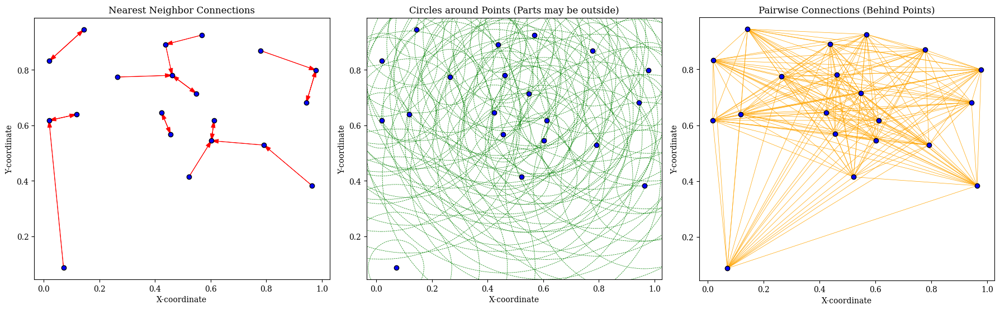

In [37]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import cKDTree

# Generate 20 random points in 2D space
np.random.seed(0)
points = np.random.rand(20, 2)

# Calculate nearest neighbors
tree = cKDTree(points)
distances, indices = tree.query(points, k=2)  # Query nearest neighbor distances and indices

# Create a figure with three subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# Plotting the points and connecting nearest neighbors with arrows in the first subplot
axs[0].scatter(points[:, 0], points[:, 1], c='blue', edgecolor='black', zorder=2)
for i in range(len(points)):
    x1, y1 = points[i]
    x2, y2 = points[indices[i, 1]]  # Nearest neighbor
    
    # Calculate direction and distance
    dx = x2 - x1
    dy = y2 - y1
    length = np.sqrt(dx**2 + dy**2)
    
    # Shorten the arrow length relative to the distance between points
    arrow_length = 0.2 * length  # Adjust factor as needed
    
    # Plot arrow with adjusted length
    axs[0].arrow(x1, y1, dx, dy, color='red', head_width=0.015, head_length=0.025, linewidth=0.5, length_includes_head=True)

axs[0].set_title('Nearest Neighbor Connections')
axs[0].set_xlabel('X-coordinate')
axs[0].set_ylabel('Y-coordinate')
axs[0].set_aspect('equal', adjustable='box')

# Calculate the extent of the points in the first subplot
x_min, x_max = axs[0].get_xlim()
y_min, y_max = axs[0].get_ylim()

# Plotting circles around each point at regular intervals in the second subplot
axs[1].scatter(points[:, 0], points[:, 1], c='blue', edgecolor='black', zorder=2)
for i in range(len(points)):
    x1, y1 = points[i]
    
    # Plot circles around each point at 0.1 distance intervals
    circle_radius = 0.1
    for j in range(1, 6):  # 5 circles
        circle = plt.Circle((x1, y1), j * circle_radius, color='green', linestyle='--', fill=False, linewidth=0.5)
        axs[1].add_patch(circle)

# Set the extent of the second subplot to match the first subplot
axs[1].set_xlim(x_min, x_max)
axs[1].set_ylim(y_min, y_max)

axs[1].set_title('Circles around Points (Parts may be outside)')
axs[1].set_xlabel('X-coordinate')
axs[1].set_ylabel('Y-coordinate')
axs[1].set_aspect('equal', adjustable='box')

# Plotting pairwise connections with lines in the third subplot (behind points)
axs[2].scatter(points[:, 0], points[:, 1], c='blue', edgecolor='black', zorder=2)
for i in range(len(points)):
    for j in range(i + 1, len(points)):  # Connect each point to every other point once
        x1, y1 = points[i]
        x2, y2 = points[j]
        axs[2].plot([x1, x2], [y1, y2], color='orange', linewidth=0.5, zorder=1)  # Set zorder to 1 to plot behind points

axs[2].set_title('Pairwise Connections (Behind Points)')
axs[2].set_xlabel('X-coordinate')
axs[2].set_ylabel('Y-coordinate')
axs[2].set_aspect('equal', adjustable='box')

# Adjust layout and show plot
plt.tight_layout()
plt.show()
